# Import and set colors

In [92]:
#Import packages
import scanpy as sc
import anndata as ann
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import cm, colors
from gprofiler import gprofiler

import os 

import seaborn as sb

In [93]:
plt.rcParams['figure.figsize']=(4,3) #rescale figures
sc.settings.verbosity = 3
sc.set_figure_params(scanpy=True, dpi=100, dpi_save=300,transparent=False, fontsize=12, color_map='plasma')
sc.logging.print_header()

scanpy==1.7.1 anndata==0.7.5 umap==0.5.1 numpy==1.22.3 scipy==1.8.0 pandas==1.2.3 scikit-learn==0.24.1 statsmodels==0.12.2 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3 pynndescent==0.5.4


In [94]:
#Define a nice colour map for gene expression
colors2 = plt.cm.plasma(np.linspace(0, 1, 128))
colors3 = plt.cm.Greys_r(np.linspace(0.7,0.8,20))
colorsComb = np.vstack([colors3, colors2])
mymap2 = colors.LinearSegmentedColormap.from_list('my_colormap', colorsComb)

# Set project file paths

In [95]:
file_path = '/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Revision/'
#this is my file path please adapt it to your directory

In [96]:
data_dir =file_path +  'data/' 

In [97]:
table_dir = file_path + 'tables/'

In [98]:
sc.settings.figdir = file_path + 'figures/4b_treatment/'

In [99]:
import datetime

today = datetime.date.today().strftime('%y%m%d') #creates a YYMMDD string of today's date

# Read Data & downstream analysis

In [100]:
adata_postnorm = sc.read(data_dir + '230721adata_postnorm_scvi2_no12.h5ad')

In [10]:
adata_postnorm

AnnData object with n_obs × n_vars = 55405 × 19290
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'batch_colors', 'condition_colors', 'dendrogram_leiden_scVI', 'hvg', 'leiden', 'leiden1

# Visualization with batch correction (scVI)

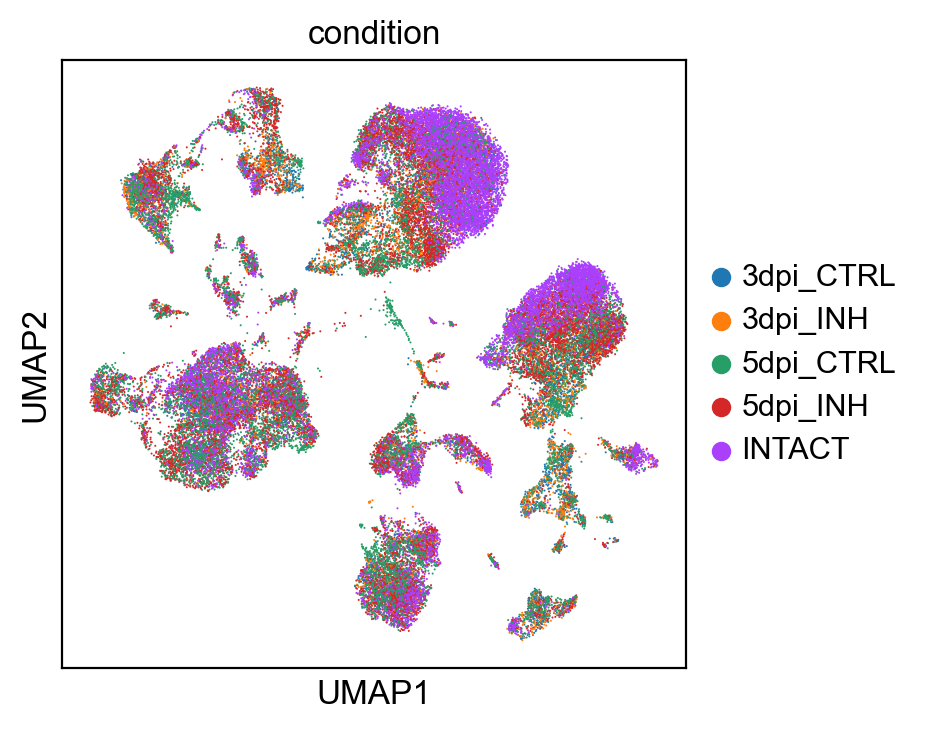

In [11]:
sc.pl.umap(adata_postnorm, color='condition')

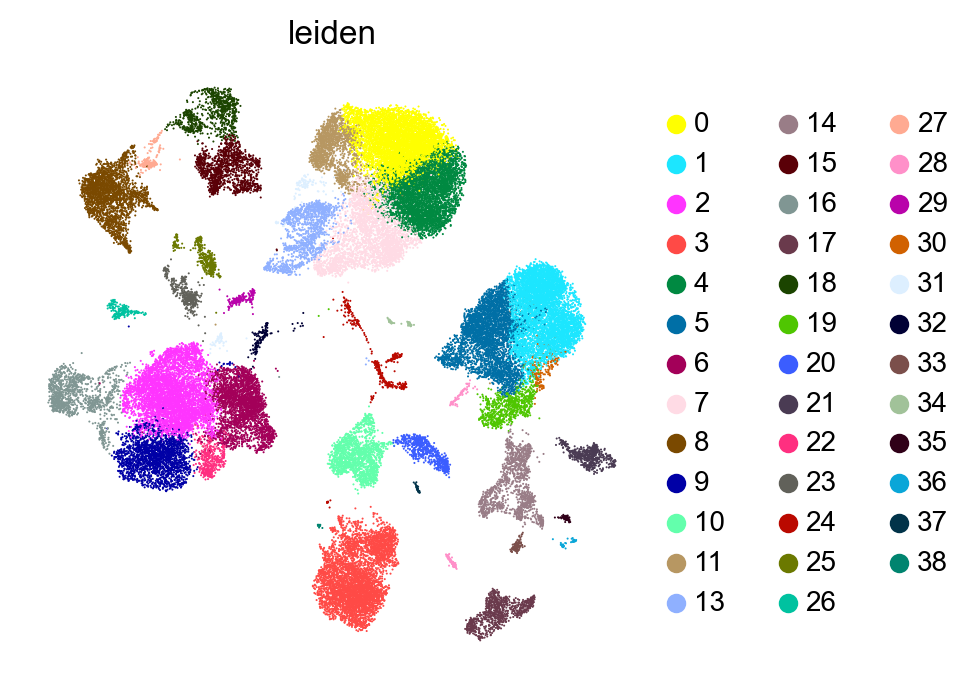

In [12]:
sc.pl.umap(adata_postnorm, color=['leiden'], legend_fontsize =float(10), legend_fontweight= 'normal', frameon= False, )

In [13]:
adata_proc=adata_postnorm.copy()

In [14]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata_proc, use_rep="X_scVI", n_neighbors=30)


computing neighbors


OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:09)


In [15]:
sc.tl.umap(adata_proc)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:40)


In [16]:
# neighbors were already computed using scVI
sc.tl.leiden(adata_proc, key_added="leiden_all")

running Leiden clustering
    finished: found 34 clusters and added
    'leiden_all', the cluster labels (adata.obs, categorical) (0:00:13)


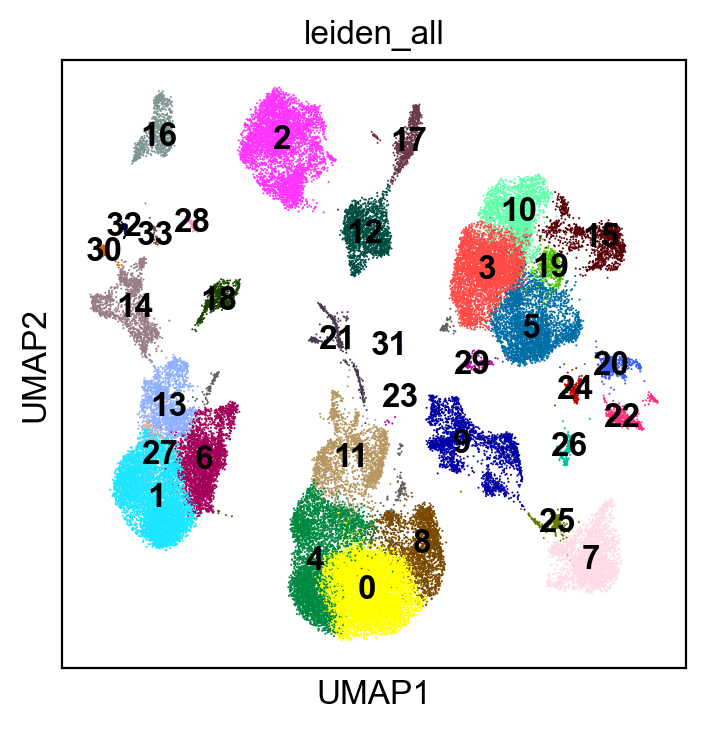

In [17]:
sc.pl.umap(adata_proc, color=['leiden_all'], legend_loc='on data')

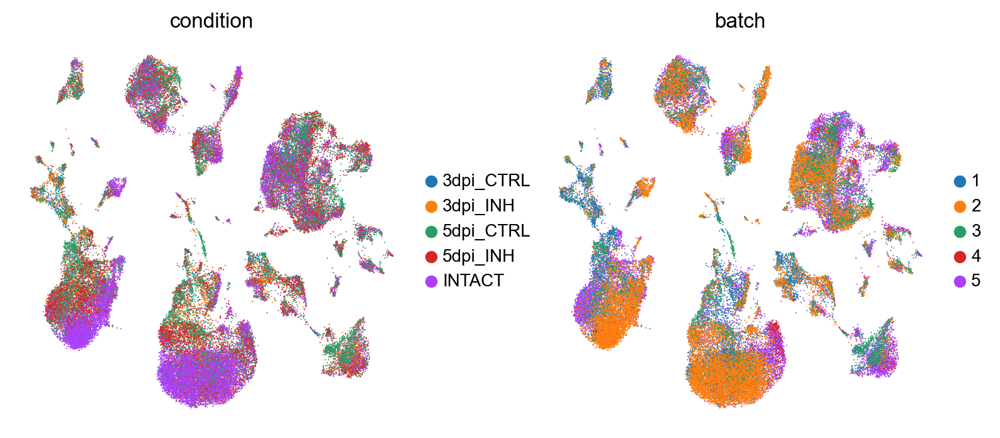

In [18]:
sc.pl.umap(adata_proc, color=['condition','batch'], legend_fontsize =float(10), legend_fontweight= 'normal', frameon= False, )

In [19]:
print(adata_proc.obs['condition'].value_counts())

INTACT       16964
5dpi_INH     15658
5dpi_CTRL    14522
3dpi_INH      4615
3dpi_CTRL     3646
Name: condition, dtype: int64


In [20]:
intact_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='INTACT'],n_obs=3646,copy=True).obs_names
five_dpi_I_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='5dpi_INH'],n_obs=3646,copy=True).obs_names
five_dpi_V_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='5dpi_CTRL'],n_obs=3646,copy=True).obs_names
three_dpi_I_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='3dpi_INH'],n_obs=3646,copy=True).obs_names
three_dpi_V_subsam = sc.pp.subsample(adata_proc[adata_proc.obs['condition']=='3dpi_CTRL'],n_obs=3646,copy=True).obs_names
adata_proc_subsam = adata_proc[list(intact_subsam) + list(five_dpi_I_subsam)+ list(five_dpi_V_subsam)+list(three_dpi_I_subsam)+list(three_dpi_V_subsam)].copy()

In [21]:
sc.tl.embedding_density(adata_proc_subsam, basis='umap', groupby='condition')

computing density on 'umap'
--> added
    'umap_density_condition', densities (adata.obs)
    'umap_density_condition_params', parameter (adata.uns)


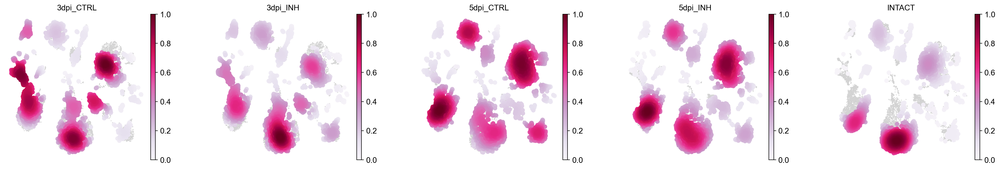

In [22]:
sc.pl.embedding_density(adata_proc_subsam, basis='umap',  key='umap_density_condition', color_map='PuRd', wspace=0.3, bg_dotsize = 8, frameon= False, ncols=5, save='_4A_distribution_downscaling.png')

## Cell cycle

In [23]:
cell_cycle_genes = [x.strip() for x in open('/Volumes/Seagate_Exp/Single_cell_112020/regev_lab_cell_cycle_genes_mouse.txt')]

In [24]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata_proc.var_names]

In [25]:
sc.tl.score_genes_cell_cycle(adata_proc, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    686 total control genes are used. (0:00:02)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs).
    730 total control genes are used. (0:00:02)
-->     'phase', cell cycle phase (adata.obs)


In [26]:
pair2= ["#009B77", "#ff8080", "#ffbf00", "#9AD255", "#9AD255",
       "#b30047",   "#dada2b", "#dada2b"]

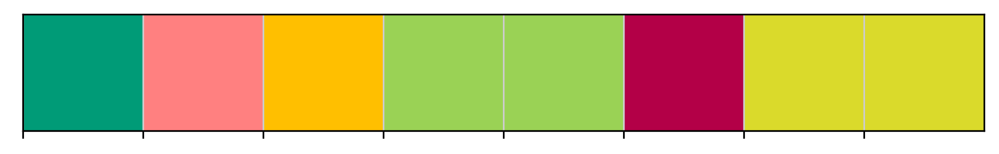

In [27]:
sb.palplot(pair2)

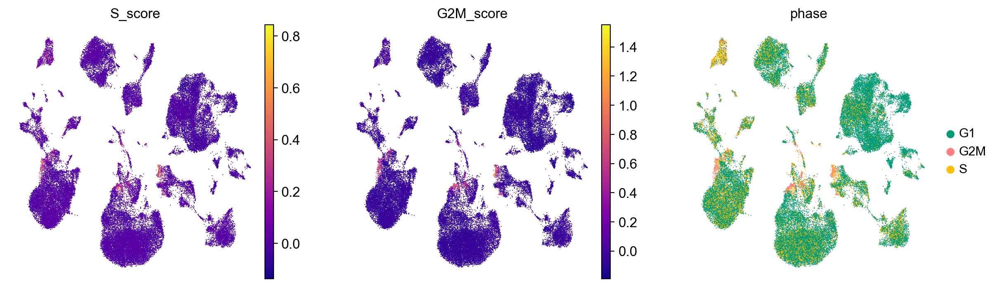

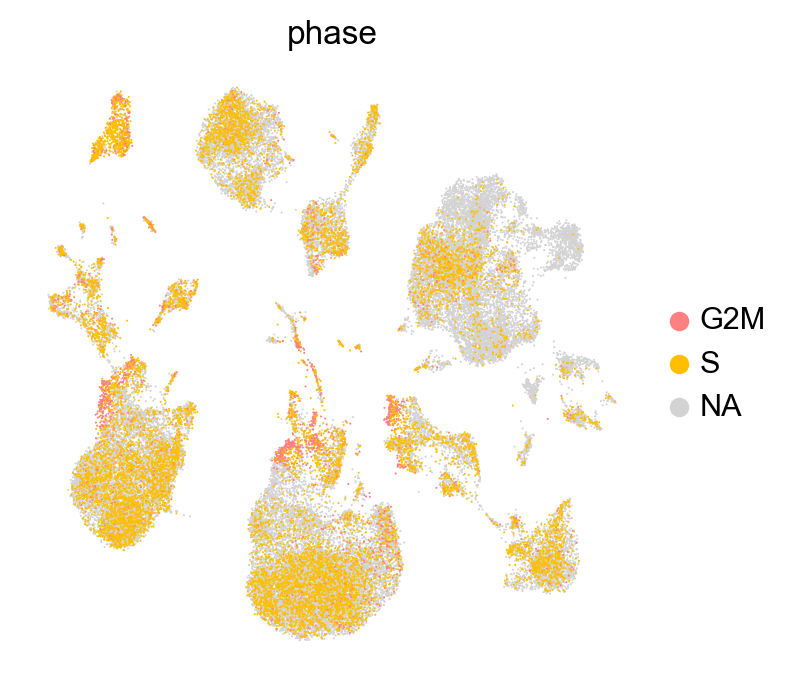

In [28]:
sc.pl.umap(adata_proc, color=['S_score', 'G2M_score', 'phase'],palette=pair2, use_raw=False, frameon=False, )
sc.pl.umap(adata_proc, color='phase',groups=['G2M','S'],  palette=pair2, use_raw=False, frameon=False)

In [29]:
sc.tl.score_genes(adata_proc, list(cell_cycle_genes), score_name='Cycling cells' )

computing score 'Cycling cells'
    finished: added
    'Cycling cells', score of gene set (adata.obs).
    945 total control genes are used. (0:00:02)


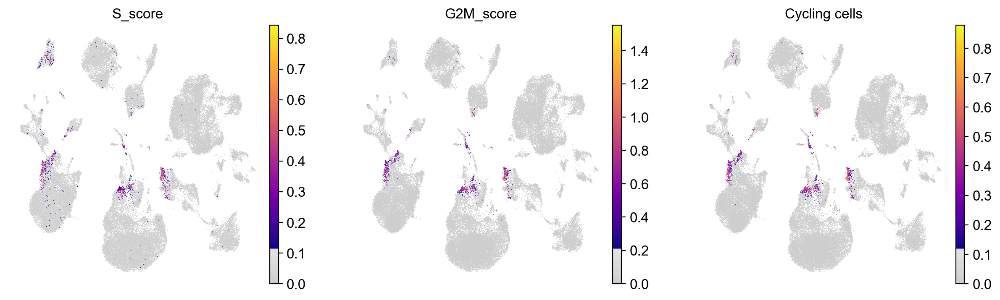

In [30]:
sc.pl.umap(adata_proc, color=['S_score', 'G2M_score', 'Cycling cells'],palette=pair2, use_raw=False, frameon=False, cmap=mymap2, vmin=0)

In [31]:
Ccc = adata_proc.obs['Cycling cells'] >0

In [32]:
Ccc

AAACCCACAACAGCTT    False
AAACCCACAGCGACCT    False
AAACCCATCCACCTCA    False
AAACCCATCCATCGTC    False
AAACCCATCTGAGAGG    False
                    ...  
TTTGTCATCACAATGC    False
TTTGTCATCCAACCAA    False
TTTGTCATCCTTGGTC    False
TTTGTCATCGATCCCT    False
TTTGTCATCTTGAGAC    False
Name: Cycling cells, Length: 55405, dtype: bool

In [33]:
adata_proc.obs['cell_cycle'] = Ccc
adata_proc.obs['cell_cycle'] = adata_proc.obs['cell_cycle'].astype('category')

In [34]:
cluster2annotation = {
    False : 'resting',
    True : 'cycling',
 }

In [35]:
adata_proc.obs['cell_cycle'] = adata_proc.obs['cell_cycle'].map(cluster2annotation).astype('category')

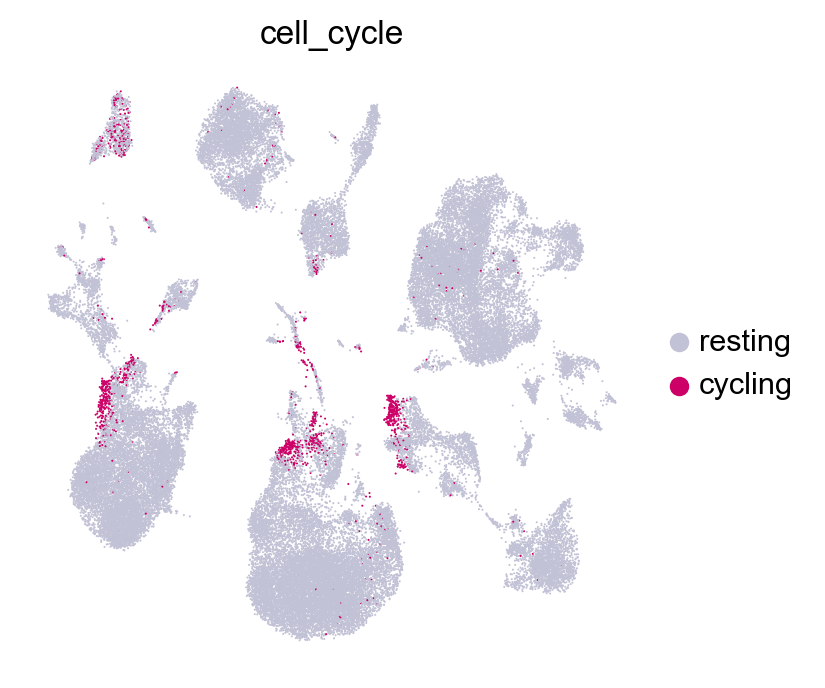

In [36]:
sc.pl.umap(adata_proc, color=['cell_cycle'],palette=['#c2c2d6', '#cc0066'], use_raw=False, frameon=False, cmap=mymap2, vmin=0)

In [37]:
adata_proc.obs['cell_cycle'].value_counts()

resting    53869
cycling     1536
Name: cell_cycle, dtype: int64

# Markers analysis

In [38]:
Markers_all_cells ={'Microglia': ['Tmem119', 'Cx3cr1', 'P2ry12', 'P2ry13', 'Gpr34', 'Olfml3', 'Selplg', 'Sparc', 'Fcrls', 'Siglech', 'Slc2a5','Mafb', 'Pmepa1', 'Cd14'],
                   'DAM':['Lpl','Cst7'], 
                   'Macrophages':['Itga4', 'Tgfbi', 'Ifitm2', 'Ifitm3', 'Tagln2','F13a1', 'Kynu', 'S100a11', 'S100a6'],
                   'BAM': [ 'Cd163', 'Mrc1','Lyve1', 'Siglec1'],
                   'Monocytes':['Ly6c2','Ccr2','Spn'],
                   'DCs':['Cd24a','Itgax','Bst2','Cd209a','Xcr1','Ccr7','Ccr9', 'Flt3','Itgae', 'Itgam','H2-Oa','Tnni2','Kctd14','Amica1','Kmo','Hepacam2'], 
                   'NKT cells':['Cd3e','Klrb1c','Ncr1'],
                   'T cells':['Cd3d','Cd3e','Cd3g','Lat','Bcl11b'],
                   'B cells':['Cd19', 'Ms4a1', 'Sdc1', 'Pax5', 'Ms4a1'],
                   'Neutrophils': ['S100a9'],
                   'Neurons':['Rbfox3','Slc17a7','Gabra1', 'Cux1','Pou3f2','Bcl11b', 'Foxp2'],
                   'OPCs':['Pdgfra', 'C1ql1'],
                   'COPs':['Neu4', 'Brca1'],
                   'MOL':['Opalin', 'Ninj2'],
                   'Astrocytes':['Sox9', 'Gfap','Aldh1l1','Atp1b2', 'Vim','Gfap','Slc1a3','Aldoc'],
                   'Pericytes':['Pecam1','Pdgfrb', 'Higd1b','Ndufa4l2','Rgs5','Kcnj8','Flt1'],
                   'VSMCs':['Acta2', 'Tagln','Myh11', 'Mustn1','Map3k7cl'],
                   'VLMCs':['Mgp', 'Slc47a1',  'Thbd', 'Col1a1', 'Col1a2'],
                   'VEC': ['Ly6c1','Cldn5', 'Ly6a','Pltp','Pglyrp1', 'Scgb3a1']
                  }#Ochocka et al., 2021, van Hove et al., 2016, Zeisel et al. 2018

In [39]:
for names in list(Markers_all_cells):
    sc.tl.score_genes(adata_proc, Markers_all_cells[names], score_name=names )

computing score 'Microglia'
    finished: added
    'Microglia', score of gene set (adata.obs).
    250 total control genes are used. (0:00:02)
computing score 'DAM'
    finished: added
    'DAM', score of gene set (adata.obs).
    100 total control genes are used. (0:00:02)
computing score 'Macrophages'
    finished: added
    'Macrophages', score of gene set (adata.obs).
    350 total control genes are used. (0:00:02)
computing score 'BAM'
    finished: added
    'BAM', score of gene set (adata.obs).
    150 total control genes are used. (0:00:02)
computing score 'Monocytes'
    finished: added
    'Monocytes', score of gene set (adata.obs).
    150 total control genes are used. (0:00:02)
computing score 'DCs'
    finished: added
    'DCs', score of gene set (adata.obs).
    550 total control genes are used. (0:00:02)
computing score 'NKT cells'
    finished: added
    'NKT cells', score of gene set (adata.obs).
    100 total control genes are used. (0:00:02)
computing score 'T cells

In [40]:
#Calculate marker genes check for 100 use raw data for markers
sc.tl.rank_genes_groups(adata_proc, groupby='leiden_all',  method='t-test_overestim_var')

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:41)


    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_leiden_all']`


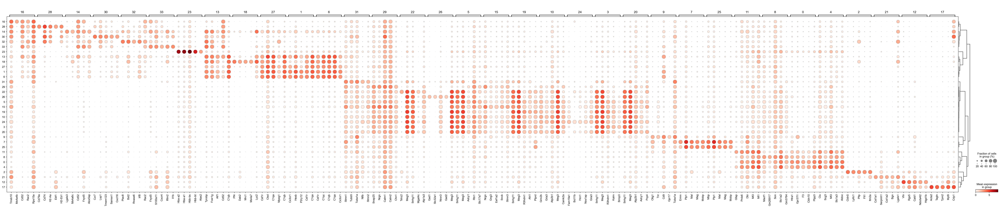

In [41]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata_proc, n_genes=5, key='rank_genes_groups' )

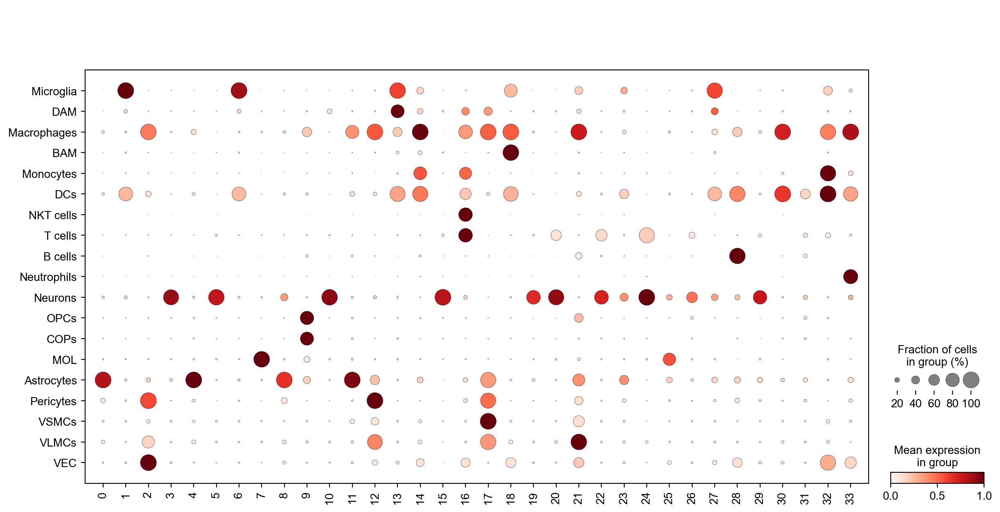

In [42]:
sc.pl.dotplot(adata_proc, list(Markers_all_cells),
              'leiden_all',  swap_axes=True, standard_scale='var',
             )#  var_group_rotation=90, dendrogram=True, )#save='adata_ctr_proc_markers_ctrinjpng')


In [43]:
mg = []
scores = []
for i in range(0,34):
    mg = [j[i] for j in adata_proc.uns['rank_genes_groups']['names']][:20]
    scores = [j[i] for j in adata_proc.uns['rank_genes_groups']['scores']][:20]
    print('marker genes in louvain cluster: ' + str(i))
    for j in range (0,len(mg)):
        print(mg[j])
    print('-----------------')

marker genes in louvain cluster: 0
Htra1
Gpr37l1
F3
Cldn10
Plpp3
Mfge8
Aldoc
Slc7a10
Cxcl14
Slc1a3
Gja1
Msmo1
Ntsr2
Bcan
Btbd17
Gjb6
Pla2g7
Clu
Atp1a2
Mt3
-----------------
marker genes in louvain cluster: 1
Cx3cr1
Hexb
P2ry12
Csf1r
C1qa
C1qc
Trem2
Selplg
C1qb
Gpr34
Siglech
Ctss
Laptm5
Olfml3
Fcrls
Tmem119
Lpcat2
Lgmn
Vsir
Unc93b1
-----------------
marker genes in louvain cluster: 2
Cldn5
Ly6c1
Pltp
Flt1
Itm2a
Ly6a
Slco1a4
Bsg
Egfl7
Slc2a1
Adgrl4
Abcb1a
Pglyrp1
Esam
Ramp2
Spock2
Igfbp7
Hspb1
Pecam1
Abcg2
-----------------
marker genes in louvain cluster: 3
Snhg11
Meg3
R3hdm1
Kalrn
Brinp3
Camk2a
Ptprd
Atp1a1
Arpp21
Rtn1
Syt1
mt-Nd1
2900055J20Rik
Atp2b2
Snap25
Pcsk2
A830036E02Rik
C1qtnf4
Stx1a
Mef2c
-----------------
marker genes in louvain cluster: 4
Clu
Scg3
Mt3
Slc1a3
Aldoc
Slc1a2
Gja1
Cpe
Mt1
Ntsr2
Mlc1
Plpp3
Mt2
Aqp4
Ttyh1
Prdx6
Gstm5
Mmd2
Pla2g7
Sparcl1
-----------------
marker genes in louvain cluster: 5
Snhg11
Meg3
Adcy1
Rtn1
Slc17a7
Pcsk2
Atp1a3
Syt1
Celf4
Scn2a1
Bsn
Slc24a2
Syp

In [44]:
cluster2annotation = {'0': '0_Astrocytes',
                      '1': '1_Microglia',
                      '2': '2_VEC',
                      '3': '3_Neurons',
                      '4': '4_Astrocytes',
                      '5': '5_Neurons',
                      '6': '6_Microglia',
                      '7': '7_MOL',
                      '8': '8_Astrocytes',
                      '9': '9_OPCs/COPs',
                      '10': '10_Neurons',
                      '11': '11_Astrocytes',
                      '12': '12_Pericytes',
                      '13': '13_Microglia',
                      '14': '14_Macrophages/Monocytes',
                      '15': '15_Neurons',
                      '16': '16_NKT/T cells',
                      '17': '17_VSMCs',
                      '18': '18_BAM',
                      '19': '19_Neurons',
                      '20': '20_Neurons',
                      '21': '21_VLMCs',
                      '22': '22_Neurons',
                      '23': '23_NA',
                      '24': '24_Neurons',
                      '25': '25_MOL',
                      '26': '26_Neurons',
                      '27': '27_Microglia', 
                      '28': '28_B cells', 
                      '29': '29_Neurons',
                      '30': '30_Macrophages/Monocytes',
                      '31': '31_NA',
                      '32': '32_Macrophages/Monocytes',
                      '33': '33_Neutrophils'
}

In [45]:
cluster2annotation_g = {'0': 'Astrocytes',
                        '1': 'Microglia',
                        '2': 'VEC',
                        '3': 'Neurons',
                        '4': 'Astrocytes',
                        '5': 'Neurons',
                        '6': 'Microglia',
                        '7': 'MOL',
                        '8': 'Astrocytes',
                        '9': 'OPCs/COPs',
                        '10': 'Neurons',
                        '11': 'Astrocytes',
                        '12': 'Pericytes',
                        '13': 'Microglia',
                        '14': 'Macrophages/Monocytes',
                        '15': 'Neurons',
                        '16': 'NKT/T cells',
                        '17': 'VSMCs',
                        '18': 'BAM',
                        '19': 'Neurons',
                        '20': 'Neurons',
                        '21': 'VLMCs',
                        '22': 'Neurons',
                        '23': 'NA',
                        '24': 'Neurons',
                        '25': 'MOL',
                        '26': 'Neurons',
                        '27': 'Microglia', 
                        '28': 'B cells', 
                        '29': 'Neurons',
                        '30': 'Macrophages/Monocytes',
                        '31': 'NA',
                        '32': 'Macrophages/Monocytes',
                        '33': '33_Neutrophils'
}

In [46]:
adata_proc.obs['annotated'] = adata_proc.obs['leiden_all'].map(cluster2annotation).astype('category')

In [47]:
adata_proc.obs['annotated_group'] = adata_proc.obs['leiden_all'].map(cluster2annotation_g).astype('category')

In [48]:
color2 = ['#333399',#'0': '0_Astrocytes',
          '#DC143C' ,#'1': '1_Microglia',  
          '#BA55D3',#'2': '3_VECV',
          '#008000',#'3': '2_Neurons',   
          '#0066cc',#'4': '4_Astrocytes', 
          '#9AD255',#'5': '6_Neurons', 
          '#fa6352',#'6': '5_Microglia',   
          '#fdd2ce',#'8': '8_MOL',   
          '#b3d9ff',#'7': '7_Astrocytes',
           '#e6007a',#'9': '9_OPCs',  
          '#20B2AA',#'10': '10_Neurons',
          '#bdcbf5',#'11': '12_Astrocytes'
          '#9985e0',#'12': '11_Pericytes',
          '#ffb399',#'13': '14_DAM', 
          '#cc3333',#'14': '15_Macrophages', 
          '#006666',#'15': '15_Neurons',
          '#ff6600',#'16': '16_NKT/T cells',
          '#DA0AD3',#'17': '17_VSMCs',
          '#801a00',#'18': '18_BAM', 
          '#99ffbb',#'19': '22_Neurons',   
          '#20B2AA',#'20': '23_Neurons',   
          '#d279a6',#'21': '21_VLMCs',
          '#326732',#'22': '24_Neurons', 
          '#666633',#23
          '#006666',#'24': '20_Neurons',
          '#fa9ef7',#'25': '31_MOL',
          '#009933',#'26': '27_Neurons',
          '#ffb399',#'27': '30_Microglia', 
          '#8e063b',#'28': 'B cells',
          '#efd6f5',#'29': '29_Erythrocytes',
          '#ff8c00',#'27': '33_Microglia',
          '#bf4080',#'28': '14_Pericytes'
          '#8e063b',#'32': '32_DC', ,   
          '#ffbf00',#'33': 'Monocytes',
          '#996600',#'34':
          '#326732',#'21': '24_Neurons',  
          '#ff6600',#'16': '16_NKT/T cells',
          '#7d87b9',#'13': '13_Astrocytes', 
         '#996600',#'28': '28_DC', #Excitatory neurons   
          '#efd6f5',#'29': '29_Erythrocytes',   
          '#ff8c00',#'33': '33_Microglia',   
          '#666633',#'34': '34_',   
           '#ffbf00',#'35': '35_Monocytes'
         ]

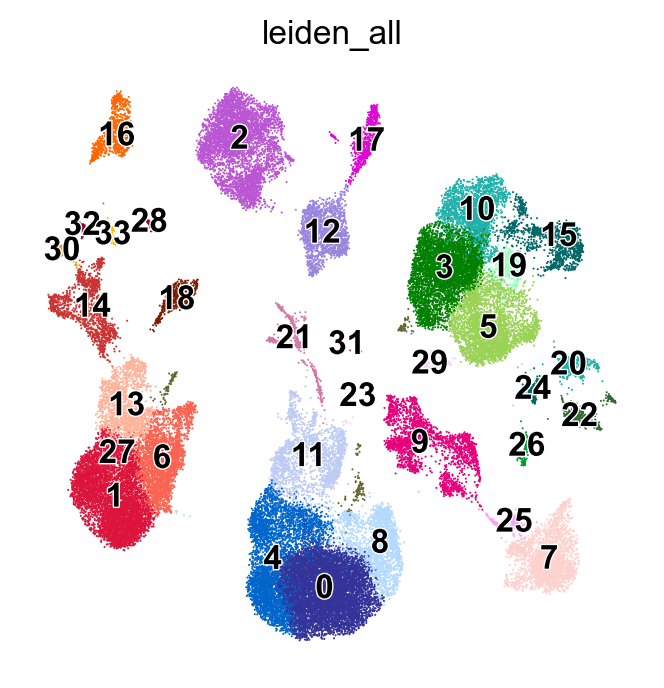

In [49]:
sc.pl.umap(adata_proc, color=['leiden_all'], legend_fontsize =float(12) , wspace=0.6, cmap=mymap2,palette=color2,
           legend_fontweight= 'bold', frameon= False , legend_loc='on data', legend_fontoutline=1, save=today+'_leiden_treated.pdf' )

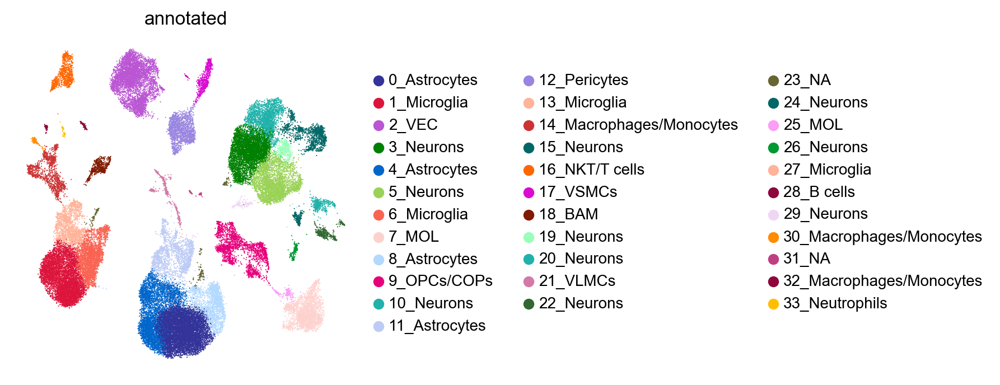

In [50]:
sc.pl.umap(adata_proc, color=['annotated'], legend_fontsize =float(10) , wspace=0.6, cmap=mymap2, palette=color2,
           legend_fontweight= 'normal', frameon= False, save=today+'_bbknn2_treated_annotated.pdf')

In [51]:
cond= ['#DC143C','#ffb3d9','#ff9933','#ffcc99',"#20B2AA",]

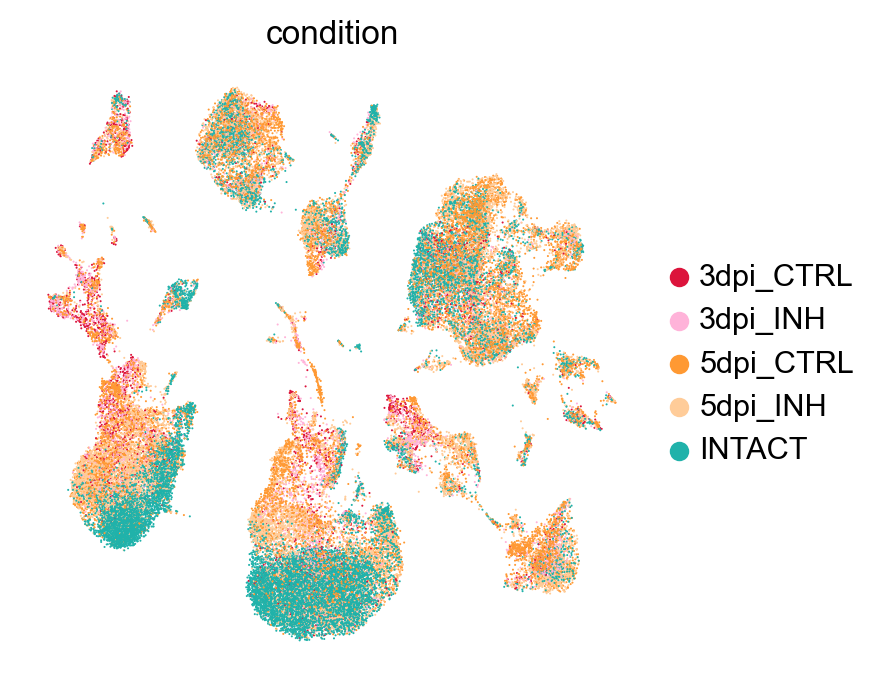

In [52]:
sc.pl.umap(adata_proc,color='condition',palette=cond, legend_fontweight= 'normal', frameon= False ,)

In [53]:
sc.tl.rank_genes_groups(adata_proc, groupby='annotated', key_added='rank_genes_treated_annotated', method='t-test_overestim_var', use_raw=True)

ranking genes
    finished: added to `.uns['rank_genes_treated_annotated']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:41)


In [54]:
sc.tl.dendrogram(adata_proc, groupby= 'annotated')

    using 'X_pca' with n_pcs = 9
Storing dendrogram info using `.uns['dendrogram_annotated']`


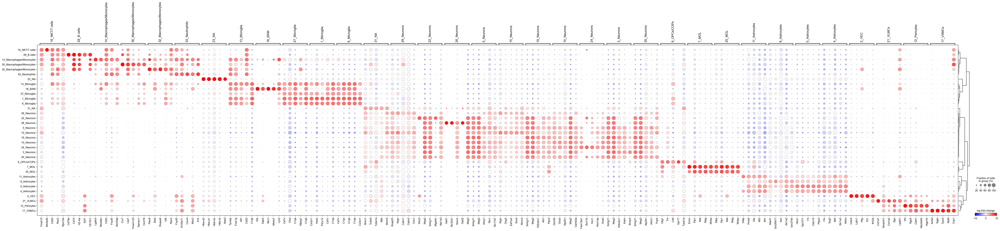

In [55]:
sc.pl.rank_genes_groups_dotplot(adata_proc, n_genes=5,values_to_plot='logfoldchanges',vmin=-10,vmax=10,cmap='bwr', 
                                key='rank_genes_treated_annotated', save="_treated.pdf" )

In [56]:
adata_proc.write(data_dir+today + "adata_proc_treated_annotated_scVI.h5ad", compression='gzip') 

# Plots for figures

In [57]:
adata_proc

AnnData object with n_obs × n_vars = 55405 × 19290
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_all', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'cell_cycle', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VEC', 'annotated', 'annotated_group'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_coun

In [58]:
df = adata_proc.obs[['n_genes_by_counts','total_counts', 'sample_id']]
df_all = pd.DataFrame(df.groupby(by='sample_id')['n_genes_by_counts'].apply(np.mean).values,
                      index=df.groupby(by='sample_id')['n_genes_by_counts'].apply(np.mean).index,
                      columns=['mean_genes'])

df_all['median_genes']=df.groupby(by='sample_id')['n_genes_by_counts'].apply(np.median).values
df_all['mean_counts']=df.groupby(by='sample_id')['total_counts'].apply(np.mean).values
df_all['median_counts']=df.groupby(by='sample_id')['total_counts'].apply(np.median).values
df_all

,mean_genes,median_genes,mean_counts,median_counts
sample_id,,,,
21L008532,3067.609646,2679.5,10287.391602,7025.0
21L008533,3224.828655,2865.0,11169.867188,7886.0
MUC13721,2120.193946,1928.5,5671.687012,4635.5
MUC13722,2305.011351,2006.5,7928.243652,5452.5
MUC13723,2402.583519,2054.0,8727.434570,5639.5
MUC13724,2377.865024,2084.0,8039.015137,5715.0
MUC13725,2416.739447,2132.0,8246.076172,5949.5
MUC13726,2067.473727,1859.0,5355.974121,4446.0
MUC13727,2383.982477,2018.5,7661.901855,5160.5


In [59]:
df = adata_proc.obs[['n_genes_by_counts','total_counts', 'condition']]
df_all = pd.DataFrame(df.groupby(by='condition')['n_genes_by_counts'].apply(np.mean).values,
                      index=df.groupby(by='condition')['n_genes_by_counts'].apply(np.mean).index,
                      columns=['mean_genes'])

df_all['median_genes']=df.groupby(by='condition')['n_genes_by_counts'].apply(np.median).values
df_all['mean_counts']=df.groupby(by='condition')['total_counts'].apply(np.mean).values
df_all['median_counts']=df.groupby(by='condition')['total_counts'].apply(np.median).values
df_all

,mean_genes,median_genes,mean_counts,median_counts
condition,,,,
3dpi_CTRL,2353.074877,2024.0,8321.920898,5539.5
3dpi_INH,2401.012784,2106.0,8162.309082,5836.0
5dpi_CTRL,2888.971010,2521.0,9616.621094,6579.0
5dpi_INH,2697.951143,2295.0,8699.335938,5794.0
INTACT,2075.218698,1861.0,5493.626953,4437.0


In [60]:
plt.rcParams['figure.figsize']=(4,5) #rescale figures

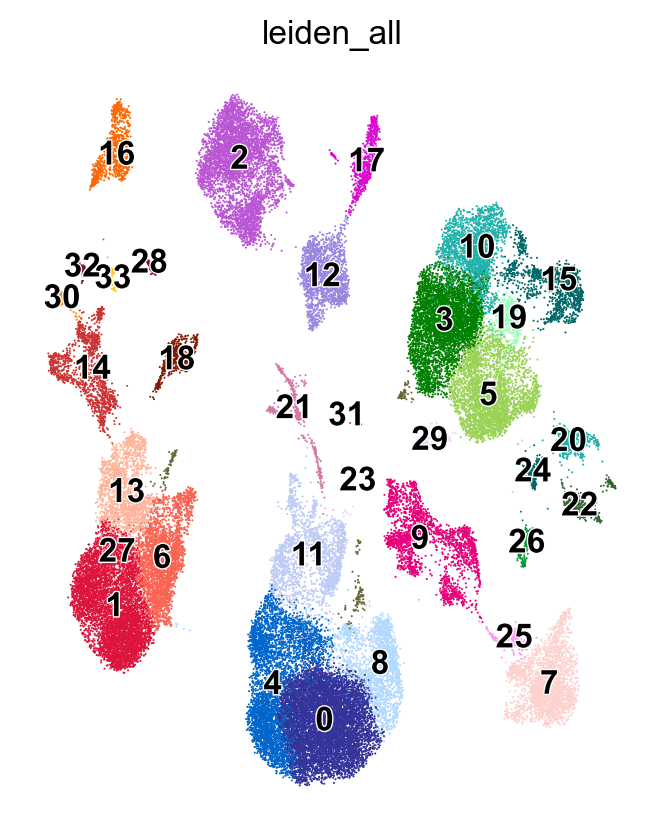

In [61]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_proc, color=['leiden_all'], legend_fontsize =float(12) , wspace=0.6, cmap=mymap2,
           legend_fontweight= 'bold', frameon= False , legend_loc='on data', legend_fontoutline=1, save=today+'_leiden_treated.png' )

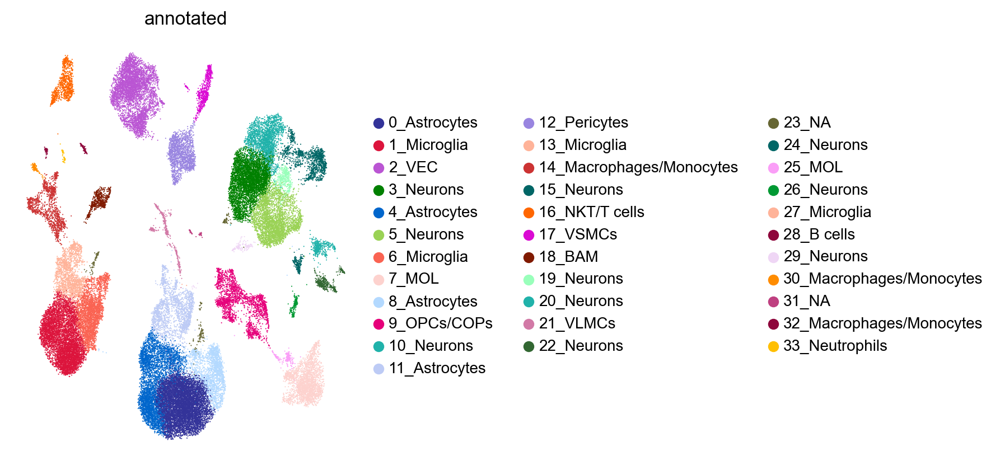

In [62]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_proc, color=['annotated'], legend_fontsize =float(10) , wspace=0.6, cmap=mymap2,
           legend_fontweight= 'normal', frameon= False,save=today+'_treated_annotated.png')

In [63]:
adata_proc

AnnData object with n_obs × n_vars = 55405 × 19290
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_all', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'cell_cycle', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VEC', 'annotated', 'annotated_group'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_coun

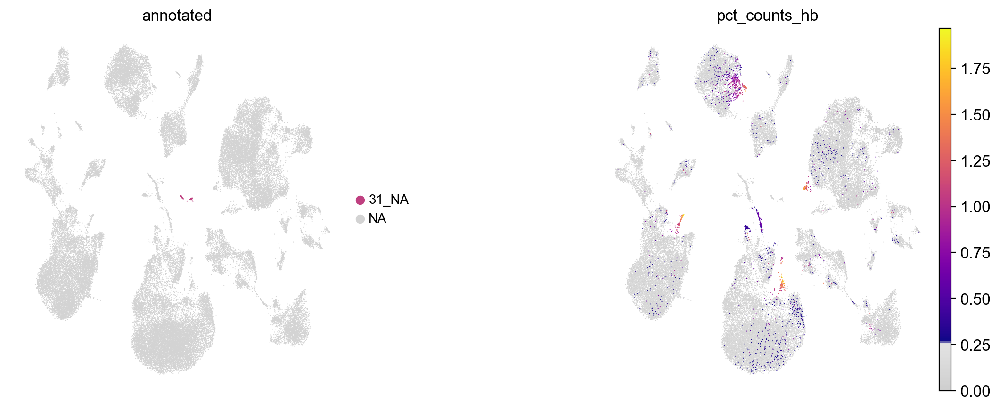

In [64]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_proc, color=['annotated','pct_counts_hb'], legend_fontsize =float(10) , wspace=0.6, cmap=mymap2, 
           legend_fontweight= 'normal', frameon= False,groups='31_NA'
          )

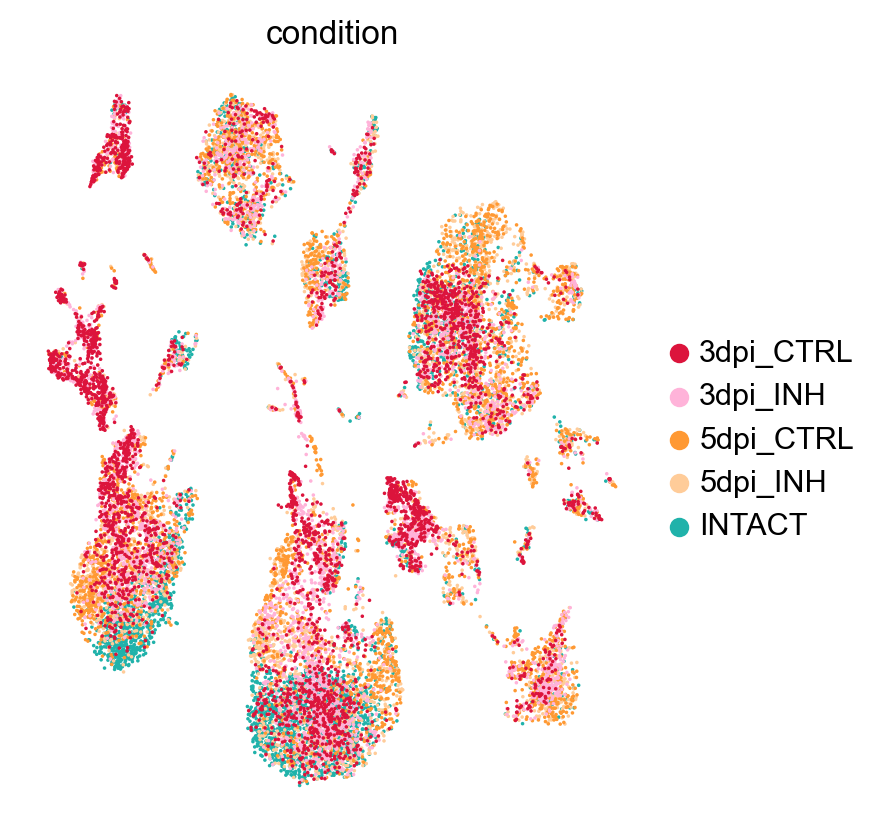

In [65]:
sc.pl.umap(adata_proc_subsam,color='condition',palette=cond, legend_fontweight= 'normal', frameon= False ,)

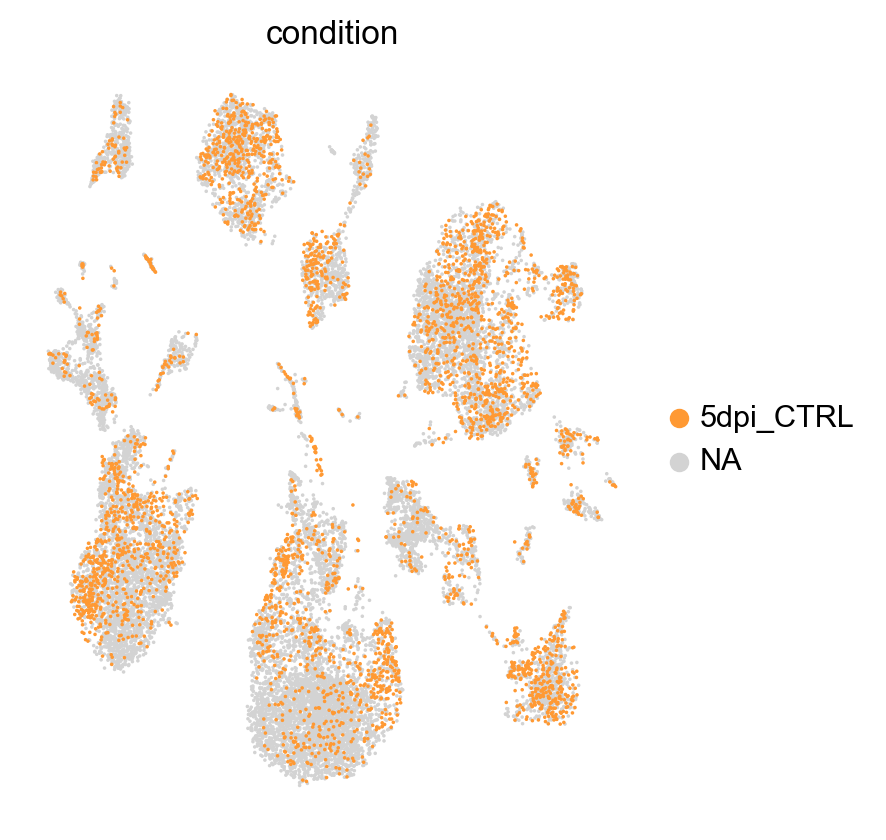

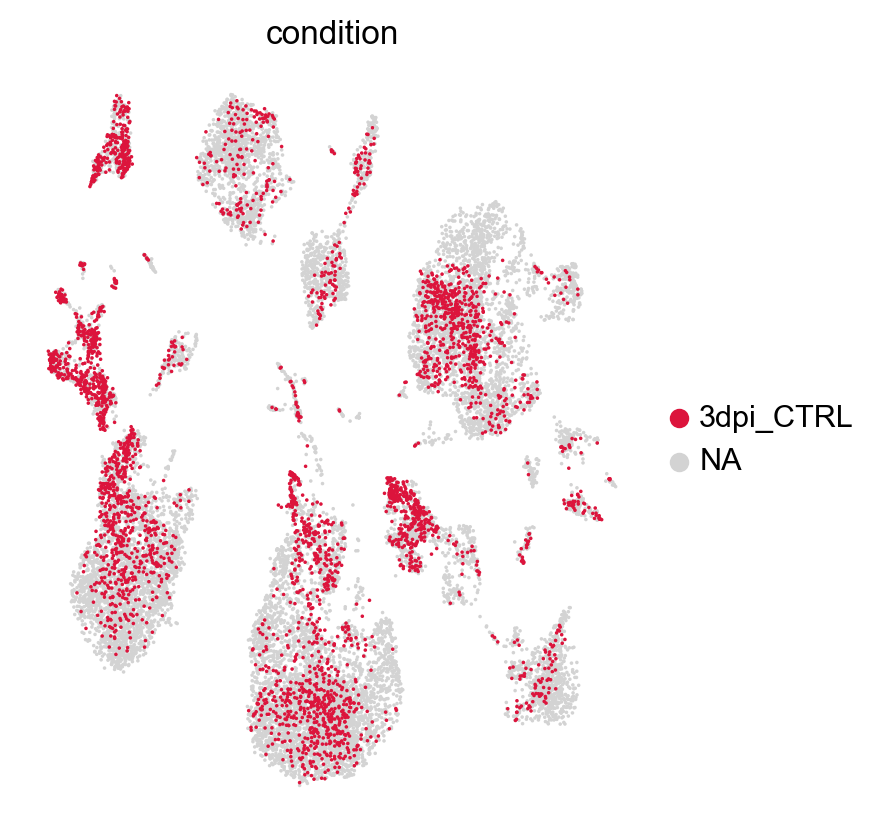

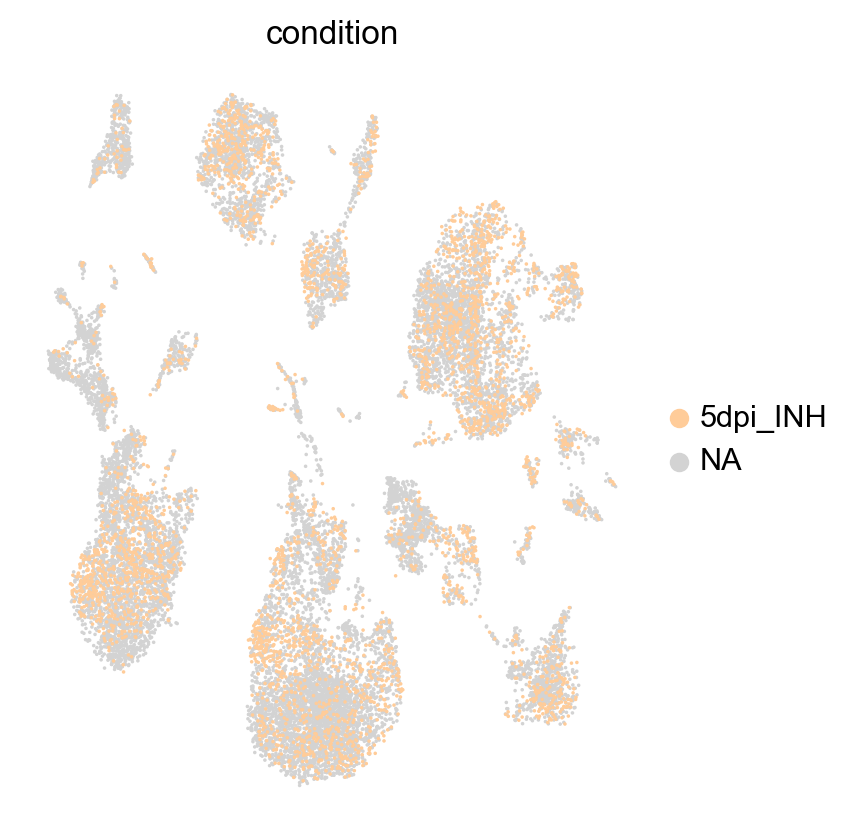

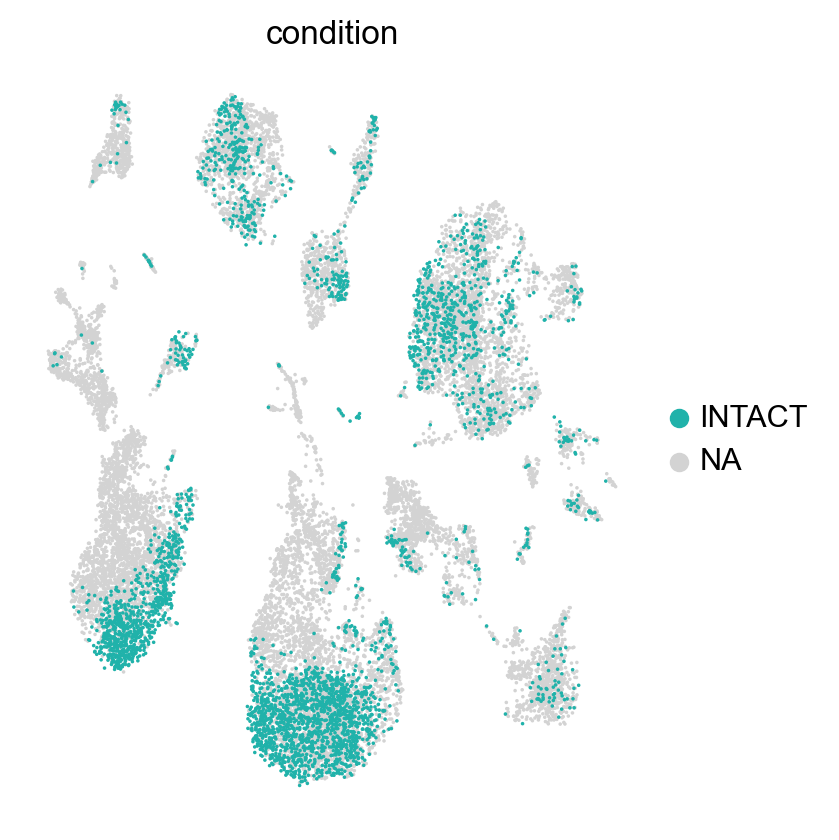

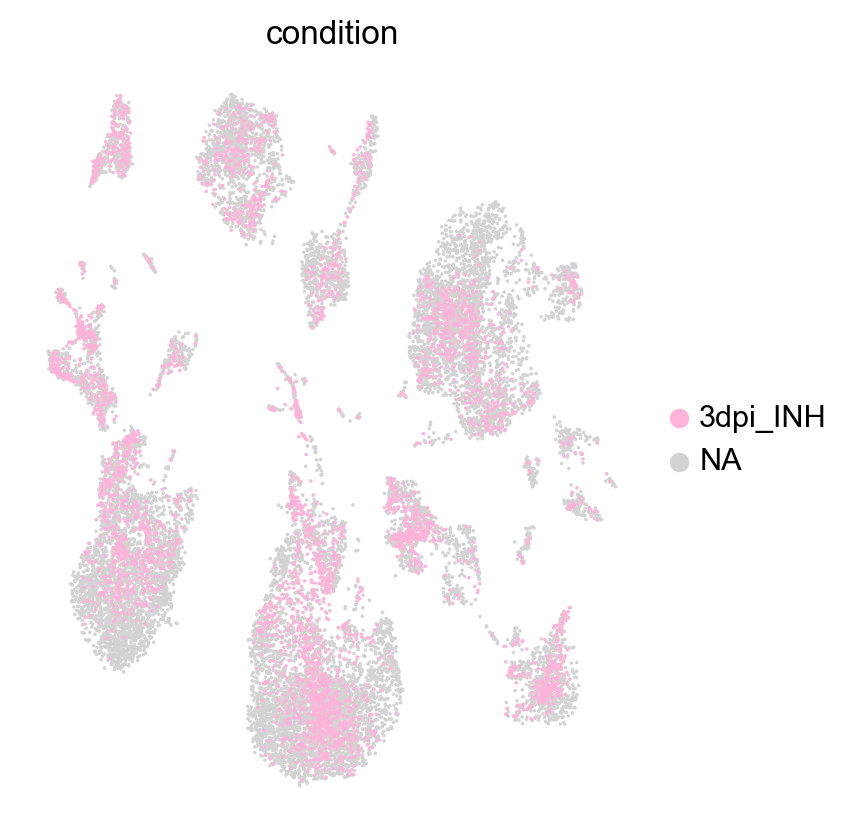

In [66]:
for i in set(adata_proc_subsam.obs['condition']):
    sc.pl.umap(adata_proc_subsam, color=['condition'],  legend_fontweight= 'normal', frameon= False, 
               groups=i, save=today+'_'+i+'.pdf')

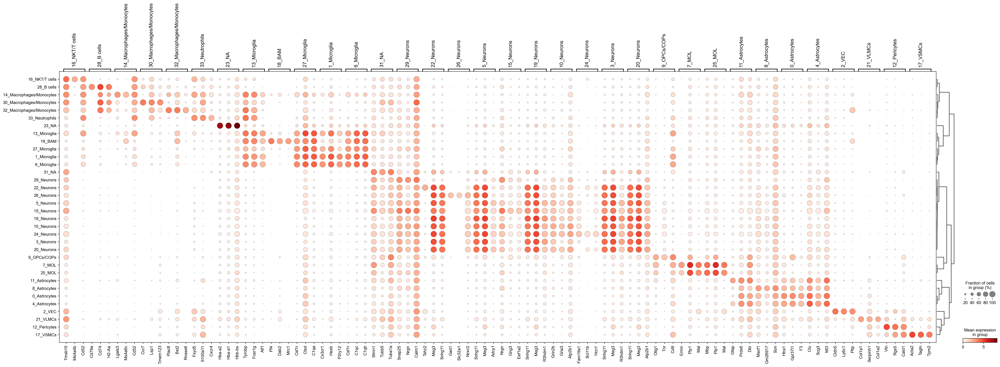

In [67]:
#it uses adata_main_correct.raw which is set to adata, so the results should be similar to the mgs from adata that I think they are
sc.pl.rank_genes_groups_dotplot(adata_proc, n_genes=3, key='rank_genes_treated_annotated', save='_scVI2_annotated.pdf')

In [68]:
result = adata_proc.uns['rank_genes_treated_annotated']
groups = result['names'].dtype.names
adata_annotated_genes = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names','scores', 'pvals','logfoldchanges']})

In [69]:
adata_annotated_genes

,0_Astrocytes_n,0_Astrocytes_s,0_Astrocytes_p,0_Astrocytes_l,1_Microglia_n,1_Microglia_s,1_Microglia_p,1_Microglia_l,2_VEC_n,2_VEC_s,...,31_NA_p,31_NA_l,32_Macrophages/Monocytes_n,32_Macrophages/Monocytes_s,32_Macrophages/Monocytes_p,32_Macrophages/Monocytes_l,33_Neutrophils_n,33_Neutrophils_s,33_Neutrophils_p,33_Neutrophils_l
0,Htra1,209.280701,0.0,4.790415,Cx3cr1,226.893204,0.0,6.090504,Cldn5,432.088043,...,1.695000e-34,3.800789,Plac8,37.292675,1.310068e-68,8.957695,Fxyd5,22.126980,6.544391e-38,5.793192
1,Gpr37l1,205.648911,0.0,5.008624,Hexb,219.851334,0.0,6.501975,Ly6c1,330.652832,...,2.675804e-32,3.660296,Bst2,36.685192,1.026417e-55,6.356867,S100a11,17.761553,1.614507e-31,5.961094
2,F3,201.638168,0.0,4.891884,P2ry12,213.296402,0.0,6.178729,Pltp,314.261414,...,1.408545e-27,3.378049,Rnase6,35.171486,2.599783e-52,8.441133,Cxcr4,17.606382,3.725063e-25,7.244000
3,Cldn10,186.166077,0.0,4.769919,Csf1r,211.149048,0.0,5.846713,Flt1,305.553070,...,6.402011e-26,3.214986,Irf8,28.344526,1.104643e-55,5.988387,Ifitm2,16.485186,5.436888e-30,5.243659
4,Plpp3,184.500748,0.0,4.740854,C1qa,197.543854,0.0,6.401582,Itm2a,294.754730,...,9.456997e-24,3.507656,Rac2,24.035589,4.765838e-51,5.355648,Il1b,16.316143,3.241176e-24,7.954210
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Atp1a1,-69.715630,0.0,-3.094074,Gpm6b,-76.088326,0.0,-3.555571,Sirpa,-67.874908,...,2.133452e-12,-1.814377,Gabbr1,-8.186114,3.592839e-12,-4.341834,Cd81,-8.469271,5.477592e-13,-3.293899
19286,Ly6e,-80.966187,0.0,-4.484730,Sparcl1,-76.390083,0.0,-3.527963,Ank2,-68.703972,...,2.758511e-12,-1.406740,Ptn,-8.279744,1.109337e-12,-3.391680,mt-Co3,-8.622448,2.659500e-13,-2.854865
19287,Mef2c,-84.788925,0.0,-3.322484,Prnp,-78.466866,0.0,-3.356837,Tspan7,-70.549049,...,3.799196e-12,-1.422238,Prnp,-8.577187,3.537320e-13,-3.562198,mt-Nd1,-8.692474,1.385082e-13,-3.271433
19288,App,-91.527687,0.0,-3.518147,mt-Atp6,-82.208839,0.0,-1.806123,Gpm6b,-72.801498,...,2.970465e-12,-3.179253,Ckb,-9.184534,2.099054e-15,-2.703365,mt-Atp6,-8.740956,8.725730e-14,-2.574676


In [70]:
adata_annotated_genes.to_csv(table_dir+today+'adata_annotated_treated_genes.csv')

In [71]:
pd.DataFrame(adata_proc.var_names).to_csv(table_dir+today+'bg_genes.csv')

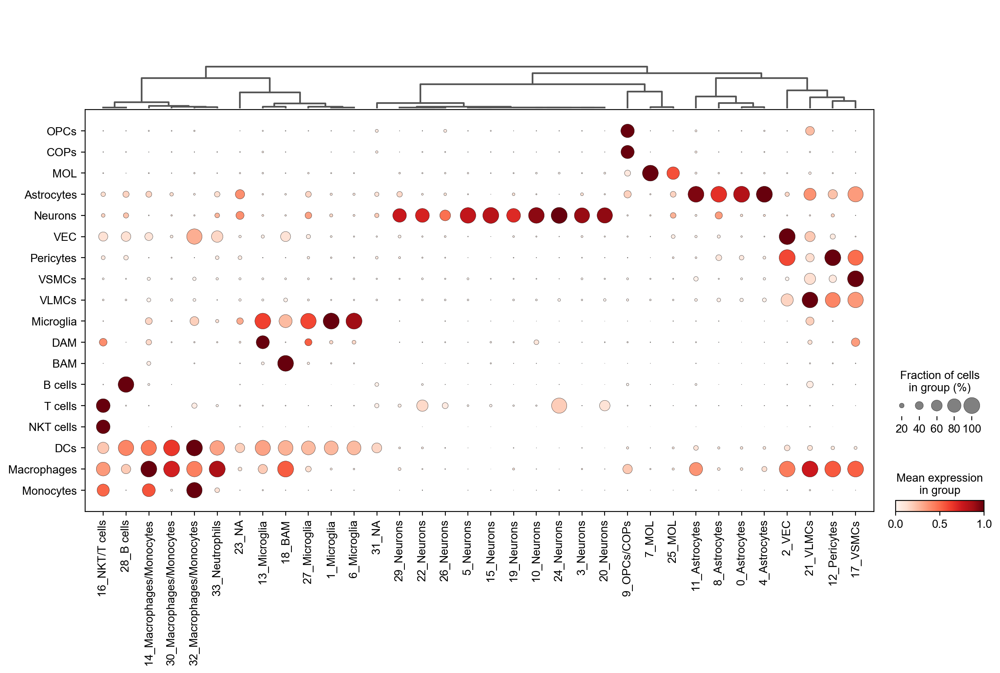

In [72]:
sc.pl.dotplot(adata_proc, ['OPCs','COPs', 'MOL',  'Astrocytes', 'Neurons','VEC','Pericytes', 'VSMCs', 'VLMCs',  'Microglia', 'DAM', 'BAM','B cells',  'T cells', 'NKT cells', 
                                   'DCs','Macrophages', 'Monocytes'],
              'annotated',  standard_scale='var', swap_axes=True, var_group_rotation=90, dendrogram=True,)# save='adata_proc_markers_treated_inj.png')


## Similarity matrix

In [73]:
table_dir

'/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Revision/tables/'

In [74]:
adata_ctr= pd.read_csv(table_dir+'230721adata_annotated_genes_ctrl.csv', index_col=0) #read file other condition
adata_ctr

,0_Astrocytes_n,0_Astrocytes_s,0_Astrocytes_p,0_Astrocytes_l,1_Microglia_n,1_Microglia_s,1_Microglia_p,1_Microglia_l,2_Neurons_n,2_Neurons_s,...,27_Macrophages/Monocytes_p,27_Macrophages/Monocytes_l,28_NA_n,28_NA_s,28_NA_p,28_NA_l,29_Macrophages/Monocytes_n,29_Macrophages/Monocytes_s,29_Macrophages/Monocytes_p,29_Macrophages/Monocytes_l
0,Htra1,186.06430,0.0,4.837433,Cx3cr1,179.837170,0.0,6.029654,Snhg11,138.600570,...,1.575725e-53,10.958855,Stmn1,16.068531,7.054215e-25,3.969420,Bst2,30.129145,2.497149e-39,6.308561
1,Gpr37l1,179.31730,0.0,5.034392,Hexb,172.401260,0.0,6.454156,Meg3,131.473650,...,2.290547e-73,7.840065,Tubb5,14.281250,8.096374e-26,3.838081,Plac8,29.384186,1.744984e-45,8.933779
2,F3,169.71117,0.0,4.865520,P2ry12,168.280610,0.0,6.163699,R3hdm1,111.811844,...,4.225878e-68,7.133900,Tuba1a,12.286259,1.618514e-21,3.552332,Rnase6,27.851105,1.304731e-35,8.390790
3,Plpp3,168.32703,0.0,4.855903,Csf1r,167.443420,0.0,5.807939,Kalrn,106.517490,...,3.480773e-60,6.375915,Nfib,10.676394,3.971167e-18,3.311277,Irf8,23.367680,7.593090e-40,5.963866
4,Slc7a10,162.92610,0.0,4.766245,Selplg,157.205050,0.0,5.812582,Camk2a,98.248886,...,4.404093e-52,7.177729,Nfix,10.628957,4.180770e-18,3.011566,Rac2,21.343250,2.644425e-38,5.441374
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19285,Calm2,-65.82704,0.0,-1.791565,Sparcl1,-64.333275,0.0,-3.667198,Sepp1,-65.297900,...,5.980881e-16,-2.496786,Slc1a2,-6.330639,3.182030e-08,-3.712725,Glul,-7.031676,1.561611e-09,-3.652436
19286,Ly6e,-76.00137,0.0,-4.670836,mt-Co1,-65.047226,0.0,-1.916648,Cst3,-65.436880,...,3.371923e-16,-3.570929,mt-Nd4,-6.350672,1.231990e-08,-1.508547,Prnp,-7.085016,1.494234e-09,-3.453229
19287,Mef2c,-76.62859,0.0,-3.286598,Prnp,-66.319336,0.0,-3.509622,Cd63,-66.179886,...,7.545929e-18,-2.986211,mt-Cytb,-6.528580,5.920142e-09,-1.473652,Ptn,-7.170723,1.186457e-09,-3.559419
19288,App,-78.97557,0.0,-3.394570,Ptn,-69.219185,0.0,-3.802535,Glul,-67.292590,...,4.099941e-19,-2.759566,Ptn,-6.690423,5.404871e-09,-3.216116,Ckb,-7.616718,3.778084e-11,-2.680575


In [75]:
cluster2annotation = {'0': '0_Astrocytes',
                      '1': '1_Microglia',
                      '2': '2_Neurons',
                      '3': '3_VEC',
                      '4': '4_Astrocytes',
                      '5': '5_Microglia',
                      '6': '6_Neurons',
                      '7': '7_Astrocytes',
                      '8': '8_MOL',
                      '9': '9_Neurons',
                      '10': '10_Pericytes',
                      '11': '11_Microglia',
                      '12': '12_Astrocytes',
                      '13': '13_Macrophages/Monocytes',
                      '14': '14_OPCs',
                      '15': '15_Neurons',
                      '16': '16_NKT/T cells',
                      '17': '17_Neurons',
                      '18': '18_BAM',
                      '19': '19_VSMCs',
                      '20': '20_COPs',
                      '21': '21_Neurons',
                      '22': '22_VLMCs',
                      '23': '23_NA',
                      '24': '24_Neurons',
                      '25': '25_Neurons',
                      '26': '26_B cells',
                      '27': '27_Macrophages/Monocytes', 
                      '28': '28_NA',
                      '29': '29_Macrophages/Monocytes'
}

In [76]:
Control = dict()
Control['0_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['0_Astrocytes_n'].dropna().head(20))]
Control['1_Microglia'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['1_Microglia_n'].dropna().head(20))]
Control['2_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['2_Neurons_n'].dropna().head(20))]
Control['3_VEC'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['3_VEC_n'].dropna().head(20))]
Control['4_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['4_Astrocytes_n'].dropna().head(20))]
Control['5_Microglia'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['5_Microglia_n'].dropna().head(20))]
Control['6_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['6_Neurons_n'].dropna().head(20))]
Control['7_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['7_Astrocytes_n'].dropna().head(20))]
Control['8_MOL'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['8_MOL_n'].dropna().head(20))]
Control['9_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['9_Neurons_n'].dropna().head(20))]
Control['10_Pericytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['10_Pericytes_n'].dropna().head(20))]
Control['11_Microglia'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['11_Microglia_n'].dropna().head(20))]
Control['12_Astrocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['12_Astrocytes_n'].dropna().head(20))]
Control['13_Macrophages/Monocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['13_Macrophages/Monocytes_n'].dropna().head(20))]
Control['14_OPCs'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['14_OPCs_n'].dropna().head(20))]
Control['15_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['15_Neurons_n'].dropna().head(20))]
Control['16_NKT/T cells'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['16_NKT/T cells_n'].dropna().head(20))]
Control['17_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['17_Neurons_n'].dropna().head(20))]
Control['18_BAM'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['18_BAM_n'].dropna().head(20))]
Control['19_VSMCs'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['19_VSMCs_n'].dropna().head(20))]
Control['20_COPs'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['20_COPs_n'].dropna().head(20))]
Control['21_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['21_Neurons_n'].dropna().head(20))]
Control['22_VLMCs'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['22_VLMCs_n'].dropna().head(20))]
Control['23_NA'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['23_NA_n'].dropna().head(20))]
Control['24_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['24_Neurons_n'].dropna().head(20))]
Control['25_Neurons'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['25_Neurons_n'].dropna().head(20))]
Control['26_B cells'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['26_B cells_n'].dropna().head(20))]
Control['27_Macrophages/Monocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['27_Macrophages/Monocytes_n'].dropna().head(20))]
Control['28_NA'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['28_NA_n'].dropna().head(20))]
Control['29_Macrophages/Monocytes'] = adata_proc.var_names[np.in1d(adata_proc.var_names, adata_ctr['29_Macrophages/Monocytes_n'].dropna().head(20))]


In [77]:
plt.rcParams['figure.figsize']=(10,9) #rescale figuressc.logging.print_header()

In [78]:
adata_proc

AnnData object with n_obs × n_vars = 55405 × 19290
    obs: 'sample_id', 'condition', 'batch', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'mt_frac', 'n_counts', 'n_genes', 'doublet_score', 'doublet', 'size_factors', 'leiden', '_scvi_batch', '_scvi_labels', 'leiden_scVI', 'leiden13', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'leiden_all', 'S_score', 'G2M_score', 'phase', 'Cycling cells', 'cell_cycle', 'Microglia', 'DAM', 'Macrophages', 'BAM', 'Monocytes', 'DCs', 'NKT cells', 'T cells', 'B cells', 'Neutrophils', 'Neurons', 'OPCs', 'COPs', 'MOL', 'Astrocytes', 'Pericytes', 'VSMCs', 'VLMCs', 'VEC', 'annotated', 'annotated_group'
    var: 'gene_ids', 'feature_types', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_coun

In [79]:
cell_annotation_norm_micro = sc.tl.marker_gene_overlap(adata_proc, Control, key='rank_genes_treated_annotated', normalize='reference')

Text(0.5, 275.0880310457516, 'Control & Inhibitors')

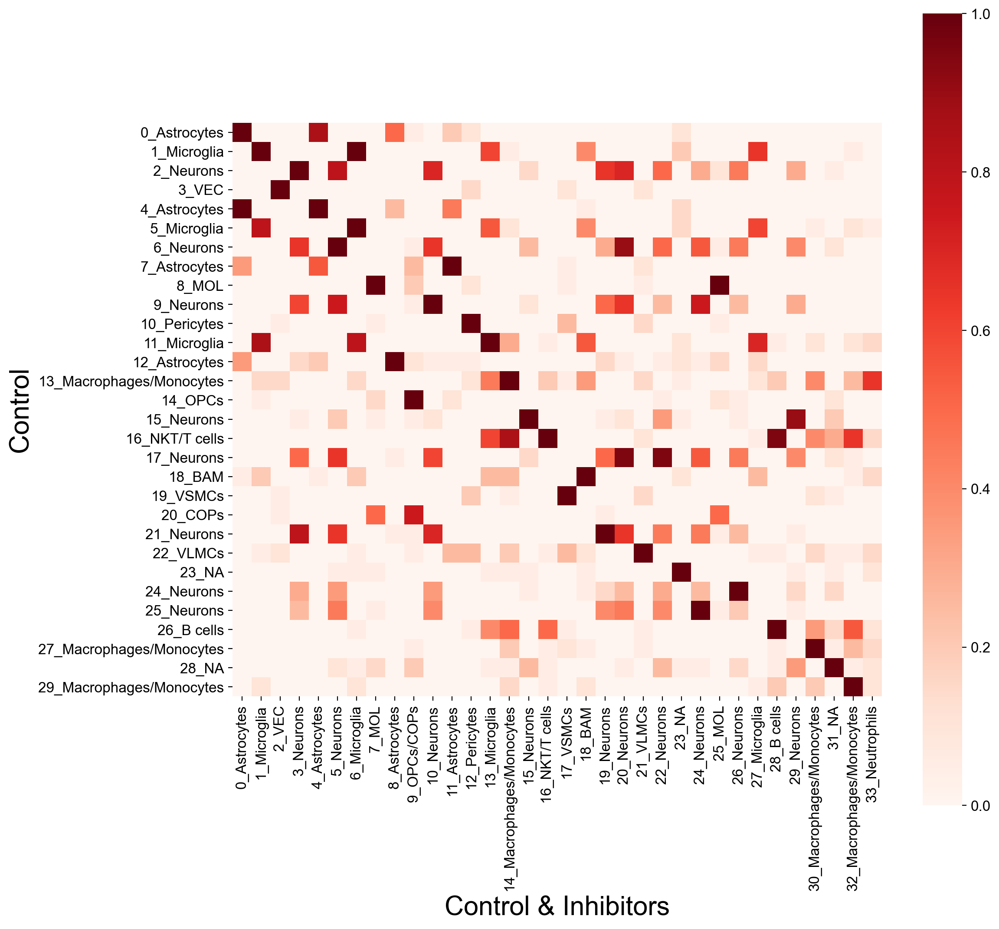

In [80]:
plt.figure(figsize=(12,12))
chart = sb.heatmap(cell_annotation_norm_micro, cbar=True,  cmap='Reds',square=True,vmin=0)
plt.yticks(rotation=0)
plt.ylabel('Control', fontsize=22)
plt.xlabel('Control & Inhibitors', fontsize=22)
#plt.savefig('/Volumes/bzb/JN/Jovica/Manuscript_CK_VS/Paper_figures_raw files/Update_figures_100123/Main_figures/Fig.6/new_plots/all_simmatris2v2.png', dpi=300)


# Split cell populations

In [81]:
adata_proc.obs['annotated_group'].value_counts()

Astrocytes               16025
Neurons                  13202
Microglia                10446
VEC                       4735
MOL                       2585
OPCs/COPs                 2123
Pericytes                 1727
Macrophages/Monocytes     1477
NKT/T cells                927
VSMCs                      669
BAM                        593
VLMCs                      412
NA                         298
B cells                    136
33_Neutrophils              50
Name: annotated_group, dtype: int64

In [82]:
adata_all_astros_treated = adata_proc[np.in1d(adata_proc.obs['annotated_group'], 
                           ['Astrocytes'])].copy()

In [83]:
adata_all_astros_treated.write(data_dir+today+'adata_all_astros_treated_scVI.h5ad', compression='gzip')

In [84]:
adata_all_oligos_treated = adata_proc[np.in1d(adata_proc.obs['annotated_group'], 
                           ['MOL', 'OPCs/COPs'])].copy()

In [85]:
adata_all_oligos_treated.write(data_dir+today+'adata_all_oligos_treated_scVI.h5ad',compression='gzip')

In [86]:
adata_all_micro_treated = adata_proc[np.in1d(adata_proc.obs['annotated_group'], 
                           ['Microglia'])].copy()

In [87]:
adata_all_micro_treated.write(data_dir+today+'adata_all_micro_treated_scVI.h5ad',compression='gzip')

In [88]:
data_dir+today+'adata_all_micro_treated_scVI.h5ad'

'/Volumes/Seagate_Exp/Paper_sc_analysis/notebooks/analysis_early_time_points/040522_corrected_notebooks/Revision/data/230807adata_all_micro_treated_scVI.h5ad'

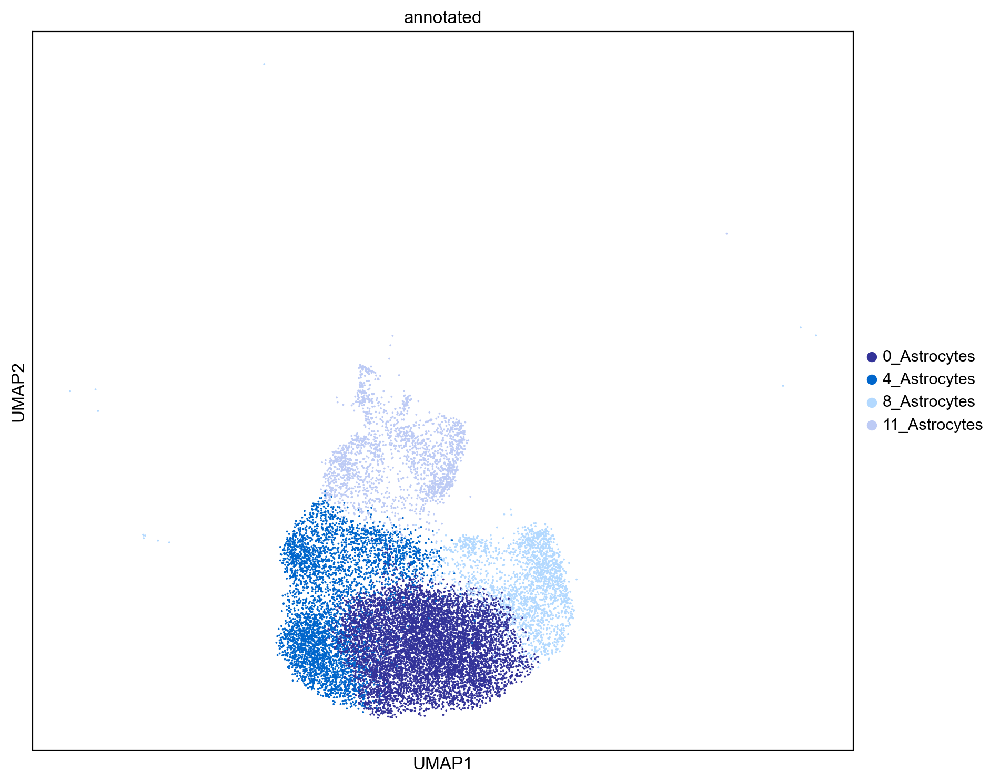

In [89]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_astros_treated, color=['annotated'])

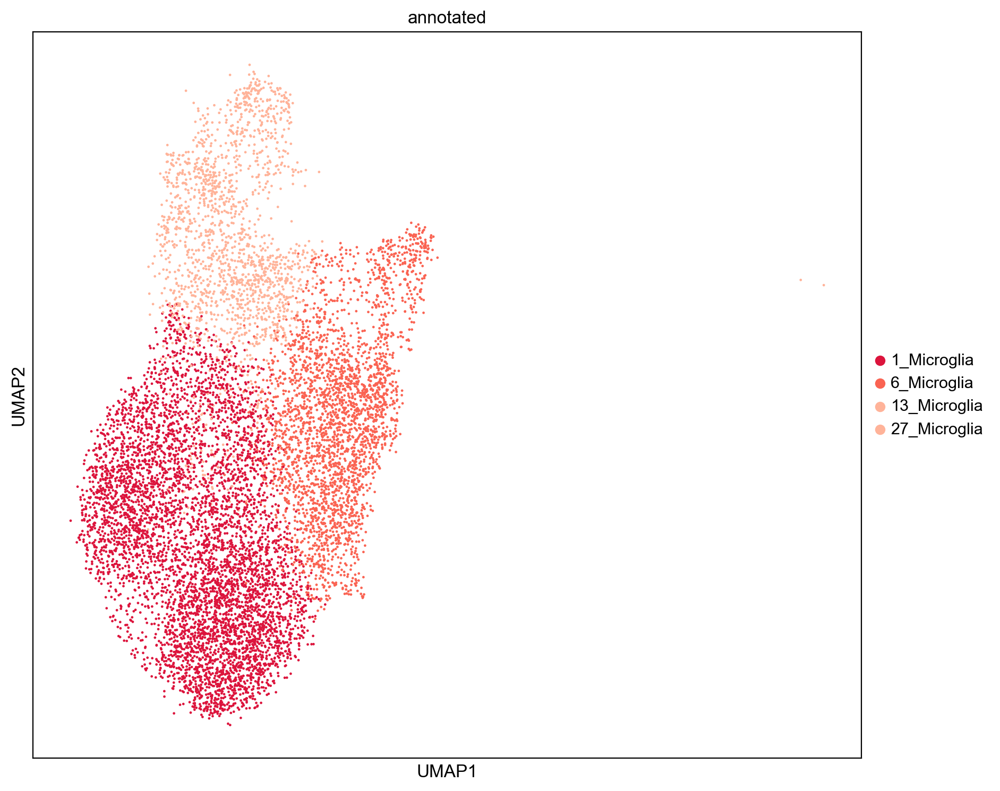

In [90]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_micro_treated, color=['annotated'])

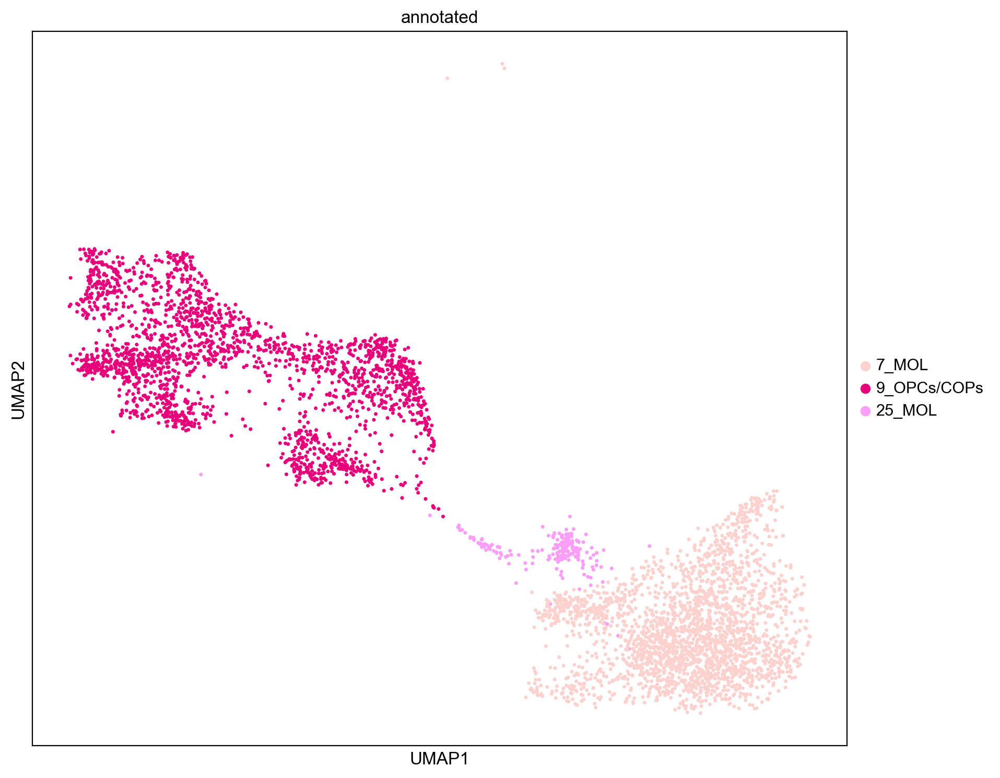

In [91]:
#Visualize the clustering and how this is reflected by different technical covariate
sc.pl.umap(adata_all_oligos_treated, color=['annotated'])